In [6]:
# Importing dependencies
import pytesseract
import cv2
import os
import matplotlib.pyplot as plt
import mpld3
import pandas as pd

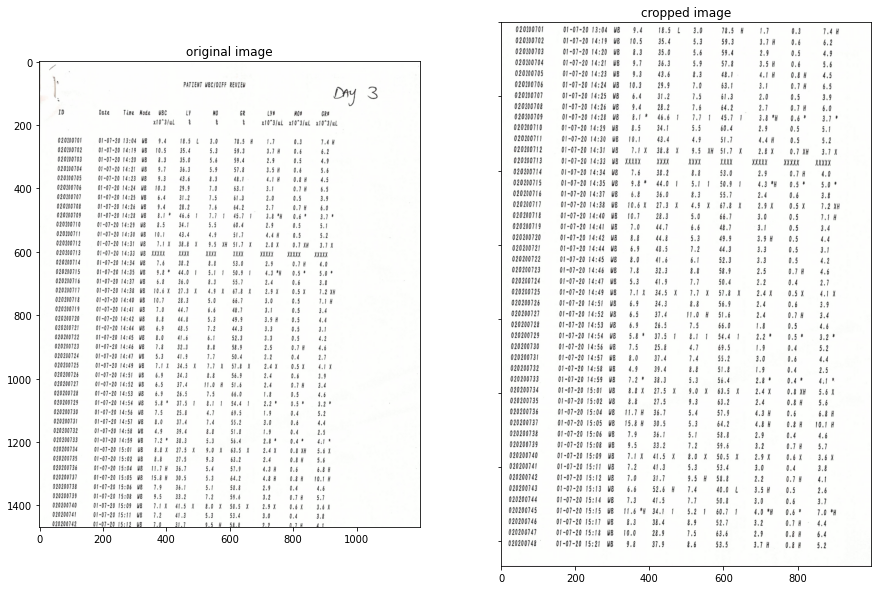

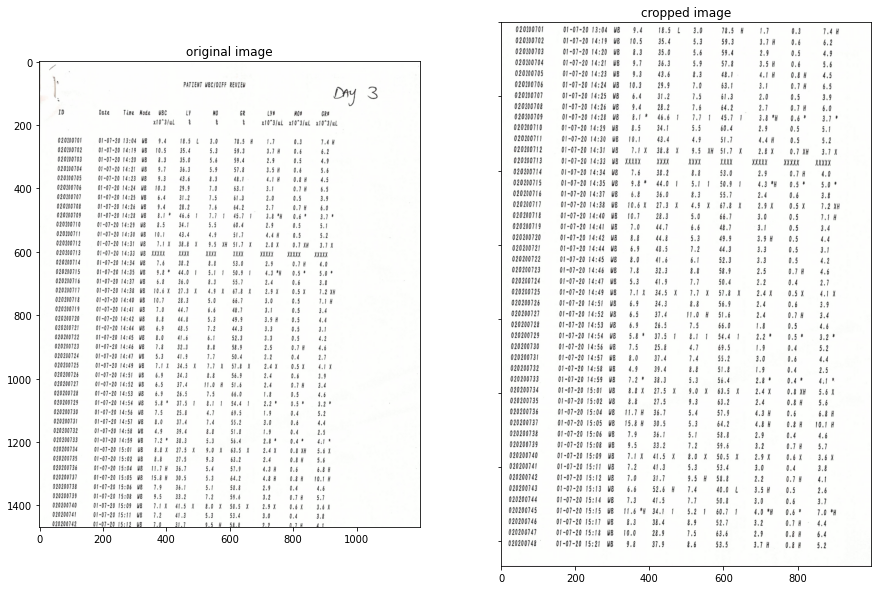

In [7]:
# Opening image file
mpld3.enable_notebook()
plt.rcParams['figure.figsize'] = [15, 10]

filename = 'test_image_1.jpg'
filepath = os.path.join(os.getcwd(), 'images', filename)

# Cropping the image file
########### Edit This if REQUIRED ##############
y=230
x=20
w=1000
h=1650
#################################################

image = cv2.imread(filepath)
crop_img = image[y:y+h, x:x+w]

# Visually verify crop
f, (ax1, ax2) = plt.subplots(1, 2, sharey=True)
ax1.imshow(image)
ax1.set_title('original image')
ax2.imshow(crop_img)
ax2.set_title('cropped image')
f

In [19]:
# Defining allowed characters in the crop immage
########### Edit This if REQUIRED ##############
allowed_characters = '1234567890-:*.WBXHL'
#################################################

custom_config = r'-c tessedit_char_whitelist={} --psm 6'.format(allowed_characters)

# Converting to data
out = pytesseract.image_to_string(crop_img, lang='eng', config=custom_config)

In [31]:
output_df = pd.DataFrame(columns=['id','date','time','mode','data1','data2','data3','data4','data5','data6','data7'])
id_arr = []
date_arr = []
time_arr = []

for line in out.splitlines():
    id_arr.append(line[0:9])
    less_id_data = line.split(' ', maxsplit=1)[1]
    date_arr.append(less_id_data[0:8])
    less_date_data = less_id_data[8:]
    ### continue working on this ###

output_df['id'] = id_arr
output_df['date'] = date_arr

output_df

,id,date,time,mode,data1,data2,data3,data4,data5,data6,data7
0,020200701,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,020200702,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,020200703,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,020200704,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,020200705,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,020200706,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,020200707,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,020200708,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,020200709,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,020200710,01-07-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# export to excel
# uses the image filename as the sheet name in excel
excel_file_name = "output.xlsx"
output_df.to_excel(excel_file_name, sheet_name=filename)